## Traffic Light Classifier - Evaluation

Notebook to evaluate the pretrained models in https://github.com/ThomasHenckel/CarND-Capstone/tree/master/Traffic_Light_Detection

In [8]:
!pip install tqdm
!pip install lxml
!pip install sklearn

    100% |████████████████████████████████| 8.0MB 345kB/s ta 0:00:01
    100% |████████████████████████████████| 27.4MB 352kB/s ta 0:00:01    74% |███████████████████████▊        | 20.3MB 686kB/s eta 0:00:11
  Stored in directory: /Users/iglopezfrancos/Library/Caches/pip/wheels/76/03/bb/589d421d27431bcd2c6da284d5f2286c8e3b2ea3cf1594c074
Successfully built sklearn


In [9]:
import numpy as np
import os
import tensorflow as tf
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
import glob
import random
import time
from tqdm import tqdm_notebook
from lxml import etree
from sklearn.metrics import accuracy_score
from sklearn.utils import shuffle

%matplotlib inline

In [3]:
# Check version of Tensorflow installed
!pip list | grep tensorflow

tensorflow           1.13.1    
tensorflow-estimator 1.13.0    


In [10]:
def load_model(file_path):
    detection_graph = tf.Graph()
    with detection_graph.as_default():
        od_graph_def = tf.GraphDef()
        with tf.gfile.GFile(file_path, 'rb') as fid:
            serialized_graph = fid.read()
            od_graph_def.ParseFromString(serialized_graph)
            tf.import_graph_def(od_graph_def, name='')
    return detection_graph
            
def load_image(image_path):
    image = Image.open(image_path)
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape((im_height, im_width, 3)).astype(np.uint8)

def run_inference(sess, ops, image_tensor, image):
    output_dict = {}
    
    time_s = time.time()
    num_detections, boxes, scores, classes = sess.run(ops, feed_dict={image_tensor: image})
    time_t = time.time() - time_s
    
    output_dict['num_detections'] = int(num_detections[0])
    output_dict['detection_classes'] = classes[0].astype(np.uint8)
    output_dict['detection_boxes'] = boxes[0]
    output_dict['detection_scores'] = scores[0]
    output_dict['detection_time'] = time_t
    
    return output_dict

In [11]:
def extract_class(detection_dict, threshold = 0.5):
    detection_classes = detection_dict['detection_classes']
    detection_scores = detection_dict['detection_scores']
    if detection_scores[0] >= threshold:
        return detection_classes[0]
    return 0

def load_labels(image_paths, labels_dir, label_map):
    labels = []
    for image_path in image_paths:
        file_name = os.path.splitext(os.path.basename(image_path))[0]
        image_label = os.path.join(labels_dir, file_name + '.xml')
        image_class = 0 # Fake class for "background" images without traffic lights

        if os.path.isfile(image_label):
            with tf.gfile.GFile(image_label, 'r') as f:
                xml = f.read()
            xml = etree.fromstring(xml)
            object_el = next(xml.iter('object'), None)
            if object_el is not None:
                class_name = next(object_el.iter('name')).text
                image_class = label_map[class_name]

        labels.append(image_class)
    return labels

def evaluate(name, graph, image_paths, labels, cpu = False):
    
    predictions = []
    
    with graph.as_default():
    
        image_tensor = graph.get_tensor_by_name('image_tensor:0')
        boxes_tensor = graph.get_tensor_by_name('detection_boxes:0')
        scores_tensor = graph.get_tensor_by_name('detection_scores:0')
        classes_tensor = graph.get_tensor_by_name('detection_classes:0')
        detections_tensor = graph.get_tensor_by_name('num_detections:0')

        ops = [detections_tensor, boxes_tensor, scores_tensor, classes_tensor]
        
        config = None
        
        if cpu:
            config = tf.ConfigProto(device_count = {'GPU': 0})

        with tf.Session(config=config) as sess:
            
            if len(image_paths) > 0:
                # Preload
                image = load_image(image_paths[0])
                run_inference(sess, ops, image_tensor, np.expand_dims(image, axis=0))
            
            time_t = 0
            for image_path in tqdm_notebook(image_paths, desc='{}'.format(name), unit=' images'):
                image = load_image(image_path)
                # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
                image = np.expand_dims(image, axis=0)
                # Actual detection.
                output_dict = run_inference(sess, ops, image_tensor, image)
                time_t += output_dict['detection_time']
                prediction = extract_class(output_dict)
                predictions.append(prediction)
                
    for i, (label, prediction) in enumerate(zip(labels, predictions)):
        if label != prediction:
            print('Image misclassified: {} (Expected: {}, Predicted: {})'.format(image_paths[i], label, prediction))
                
    accuracy = accuracy_score(labels, predictions)
    
    return accuracy, time_t * 1000

In [26]:
LABELS_MAP_PATH = os.path.join('..', 'config', 'labels_map.pbtxt')
LABELS_MAP = {'Green': 1, 'Yellow': 2, 'Red': 3}

def evaluate_models(models_dir, data_dir, models, model_file = 'frozen_inference_graph.pb', n_samples = None, cpu = False):
    image_paths = glob.glob(os.path.join(data_dir, '*.jpg'))
    labels = load_labels(image_paths, os.path.join(data_dir, 'labels'), LABELS_MAP)
    image_paths, labels = shuffle(image_paths, labels, n_samples = n_samples)
    
    for model_name in models:
        model_path = os.path.join(models_dir, model_name, model_file)
        graph = load_model(model_path)
        accuracy, total_time = evaluate(model_name, graph, image_paths, labels, cpu = cpu)
        avg_time = total_time / len(image_paths)
        fps = 1000 / avg_time
        print('Model {} Accuracy: {:.3f} (Avg Time: {:.3f} ms, FPS: {:.3f})'.format(model_name, accuracy, avg_time, fps))

In [27]:
MODELS_DIR = os.path.join('..', 'models', 'converted_to_TFv14')
DATA_DIR = os.path.join('..', 'test_images')   #'data', 'simulator')

n_samples = 13

models = ['ssd_mobilenet']

evaluate_models(MODELS_DIR, DATA_DIR, models, n_samples = n_samples, cpu = False)


Image misclassified: ../test_images/uda_loop_g.jpg (Expected: 0, Predicted: 1)
Image misclassified: ../test_images/uda_lights_y.jpg (Expected: 0, Predicted: 2)
Image misclassified: ../test_images/sim_y.jpg (Expected: 0, Predicted: 2)
Image misclassified: ../test_images/uda_lights_r.jpg (Expected: 0, Predicted: 3)
Image misclassified: ../test_images/uda_training_g.jpg (Expected: 0, Predicted: 1)
Image misclassified: ../test_images/uda_loop_r.jpg (Expected: 0, Predicted: 2)
Image misclassified: ../test_images/sim_r.jpg (Expected: 0, Predicted: 3)
Image misclassified: ../test_images/uda_training_r.jpg (Expected: 0, Predicted: 3)
Image misclassified: ../test_images/uda_lights_g.jpg (Expected: 0, Predicted: 1)
Image misclassified: ../test_images/uda_training_y.jpg (Expected: 0, Predicted: 2)
Model ssd_mobilenet Accuracy: 0.231 (Avg Time: 105.713 ms, FPS: 9.460)


## Detection



In [37]:
import numpy as np
import os
import sys
import tensorflow as tf
import time
from matplotlib import pyplot as plt
from PIL import Image
%matplotlib inline

In [21]:
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

In [49]:
MODELS_DIR = os.path.join('..', 'models', 'converted_to_TFv14') #'exported')
model_file = 'ssd_mobilenet/frozen_inference_graph.pb' #'ssd_mobilenet/frozen_inference_graph.pb'

MODEL_PATH = os.path.join(MODELS_DIR, model_file)
LABELS_MAP_PATH = os.path.join('..', 'config', 'labels_map.pbtxt') #PATH_TO_LABELS = 'labels_map.pbtxt'

NUM_CLASSES = 3

### Loadig label map


In [29]:
label_map = label_map_util.load_labelmap(LABELS_MAP_PATH)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)
print(category_index)

{1: {'id': 1, 'name': 'Green'}, 2: {'id': 2, 'name': 'Yellow'}, 3: {'id': 3, 'name': 'Red'}}


In [31]:
def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
        (im_height, im_width, 3)).astype(np.uint8)
from glob import glob

### Detection

In [33]:
detection_graph = tf.Graph()

with detection_graph.as_default():
    od_graph_def = tf.GraphDef()

    with tf.gfile.GFile(MODEL_PATH, 'rb') as fid:
        
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

In [50]:
DATA_DIR = os.path.join('..', 'test_images') 

print(os.path.join(DATA_DIR, '*.jpg'))
DATA_PATHS = glob(os.path.join(DATA_DIR, '*.jpg'))
print("Length of test images:", len(DATA_PATHS))

# Size, in inches, of the output images. (original size: 350, 280)
IMAGE_SIZE = (10, 8) 

../test_images/*.jpg
Length of test images: 13


In [48]:
image_path_1 = os.path.join('..', 'test_images', 'uda_loop_r.jpg')
image_1 = Image.open(image_path_1)
image_1.size

image_path_2 = os.path.join('..', 'test_images', 'sim_y.jpg')
image_2 = Image.open(image_path_1)
image_2.size

(350, 280)

In [47]:
with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
        # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        for image_path in DATA_PATHS:
            image = Image.open(image_path)
            # the array based representation of the image will be used later in order to prepare the
            # result image with boxes and labels on it.
            image_np = load_image_into_numpy_array(image)
            # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
            image_np_expanded = np.expand_dims(image_np, axis=0)

            time0 = time.time()

            # Actual detection.
            (boxes, scores, classes, num) = sess.run(
              [detection_boxes, detection_scores, detection_classes, num_detections],
              feed_dict={image_tensor: image_np_expanded})

            time1 = time.time()

            boxes = np.squeeze(boxes)
            scores = np.squeeze(scores)
            classes = np.squeeze(classes).astype(np.int32)
            
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np, boxes, classes, scores,
                category_index,
                use_normalized_coordinates=True,
                line_thickness=4)
            
            plt.figure(figsize=IMAGE_SIZE)
            plt.imshow(image_np)
            plt.show()

            min_score_thresh = .50
            for i in range(boxes.shape[0]):
                if scores is None or scores[i] > min_score_thresh:

                    class_name = category_index[classes[i]]['name']
                    print('{}'.format(class_name), scores[i])
                    
                    fx =  0.97428  #1345.200806
                    fy =  1.73205  #1353.838257
                    perceived_width_x = (boxes[i][3] - boxes[i][1]) * 800
                    perceived_width_y = (boxes[i][2] - boxes[i][0]) * 600

                    # ymin, xmin, ymax, xmax = box
                    # depth_prime = (width_real * focal) / perceived_width
                    perceived_depth_x = ((.1 * fx) / perceived_width_x)
                    perceived_depth_y = ((.3 * fy) / perceived_width_y )

                    estimated_distance = round((perceived_depth_x + perceived_depth_y) / 2)
                    print("Distance (metres)", estimated_distance)
                    print("Time in milliseconds", (time1 - time0) * 1000, "\n")

Red 0.9945077
Distance (metres) 0.0
Time in milliseconds 2576.3630867004395 

Red 0.9686686
Distance (metres) 0.0
Time in milliseconds 2576.3630867004395 

Red 0.89389217
Distance (metres) 0.0
Time in milliseconds 2576.3630867004395 



Red 0.9722489
Distance (metres) 0.0
Time in milliseconds 158.10823440551758 



Green 0.7906953
Distance (metres) 0.0
Time in milliseconds 340.88897705078125 



Yellow 0.646701
Distance (metres) 0.0
Time in milliseconds 175.15206336975098 



Green 0.97036386
Distance (metres) 0.0
Time in milliseconds 331.2509059906006 



Red 0.9829682
Distance (metres) 0.0
Time in milliseconds 378.57699394226074 



Green 0.9995971
Distance (metres) 0.0
Time in milliseconds 200.7119655609131 



Yellow 0.9970596
Distance (metres) 0.0
Time in milliseconds 189.7578239440918 



Yellow 0.95012593
Distance (metres) 0.0
Time in milliseconds 374.96209144592285 

Yellow 0.8846628
Distance (metres) 0.0
Time in milliseconds 374.96209144592285 



Yellow 0.9549977
Distance (metres) 0.0
Time in milliseconds 390.4581069946289 



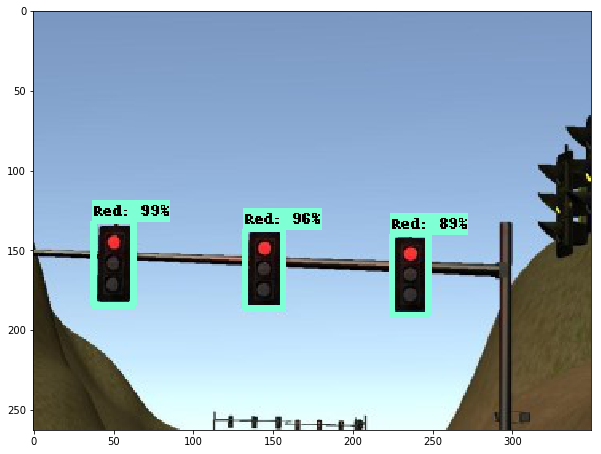

Red 0.9945077
Distance (metres) 0.0
Time in milliseconds 3661.8082523345947 

Red 0.9686686
Distance (metres) 0.0
Time in milliseconds 3661.8082523345947 

Red 0.89389217
Distance (metres) 0.0
Time in milliseconds 3661.8082523345947 



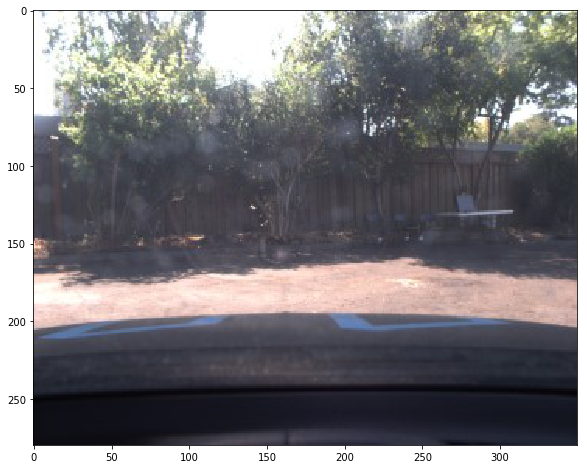

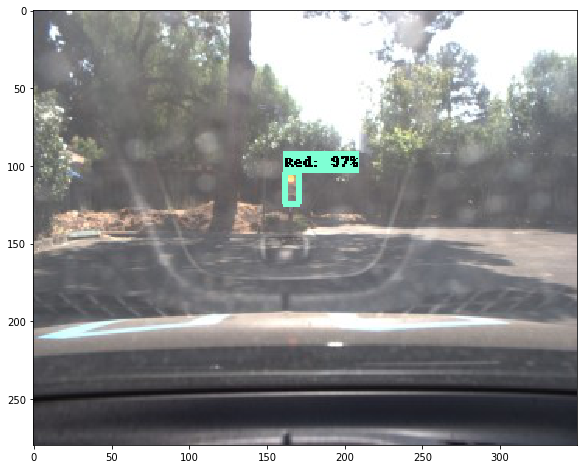

Red 0.9722489
Distance (metres) 0.0
Time in milliseconds 94.84481811523438 



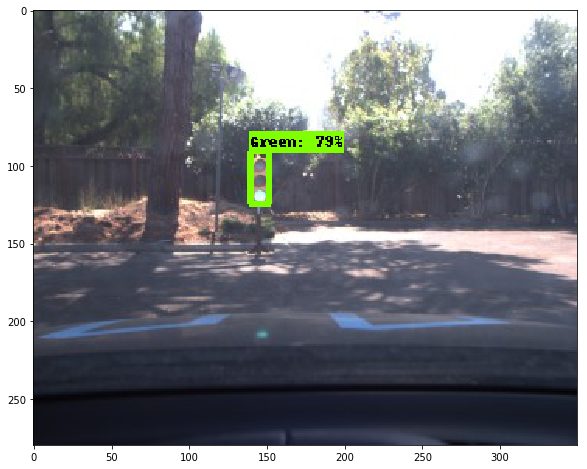

Green 0.7906953
Distance (metres) 0.0
Time in milliseconds 82.96608924865723 



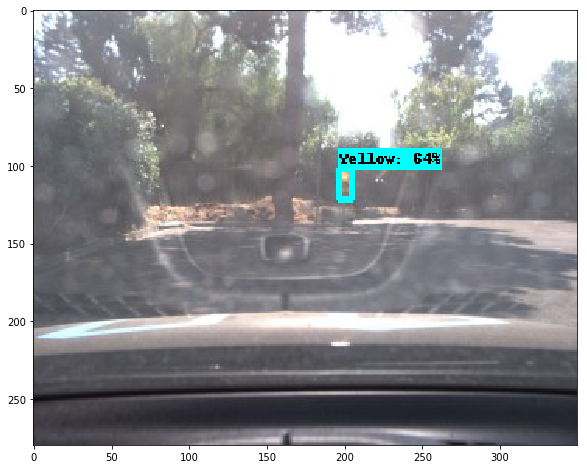

Yellow 0.646701
Distance (metres) 0.0
Time in milliseconds 89.45775032043457 



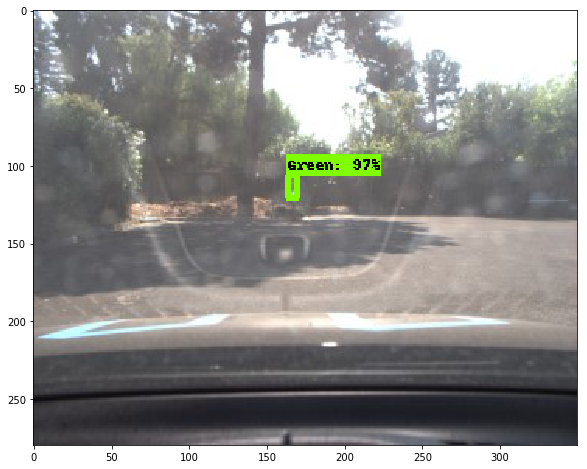

Green 0.97036386
Distance (metres) 0.0
Time in milliseconds 99.51472282409668 



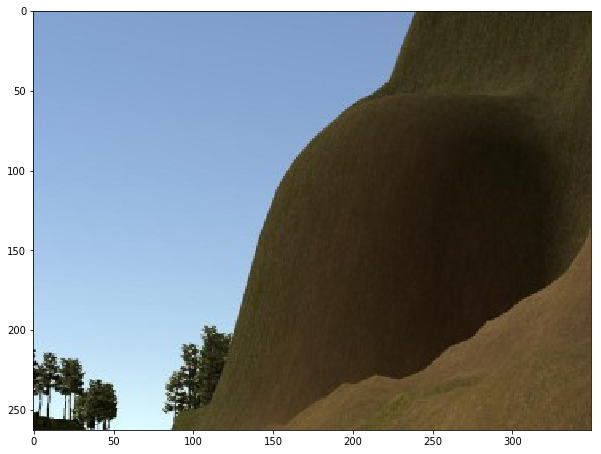

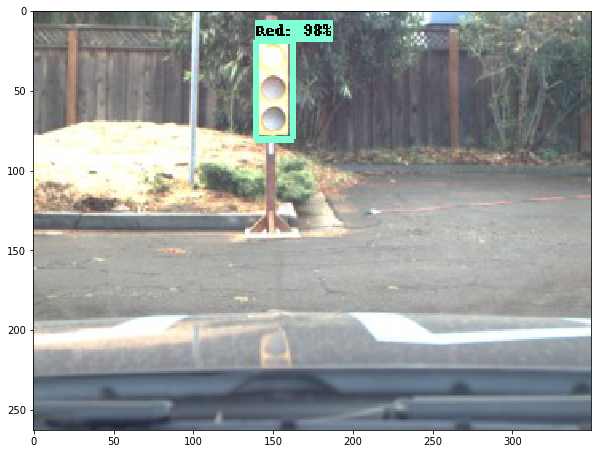

Red 0.9829682
Distance (metres) 0.0
Time in milliseconds 86.05694770812988 



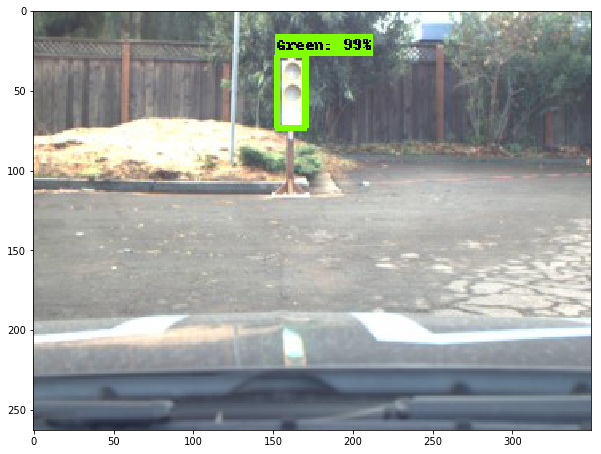

Green 0.9995971
Distance (metres) 0.0
Time in milliseconds 108.35671424865723 



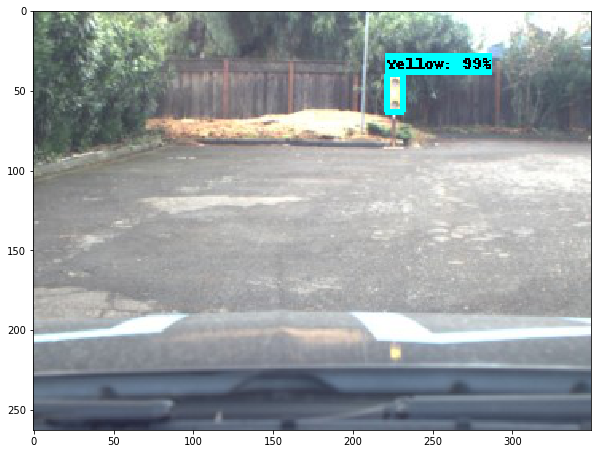

Yellow 0.9970596
Distance (metres) 0.0
Time in milliseconds 166.3229465484619 



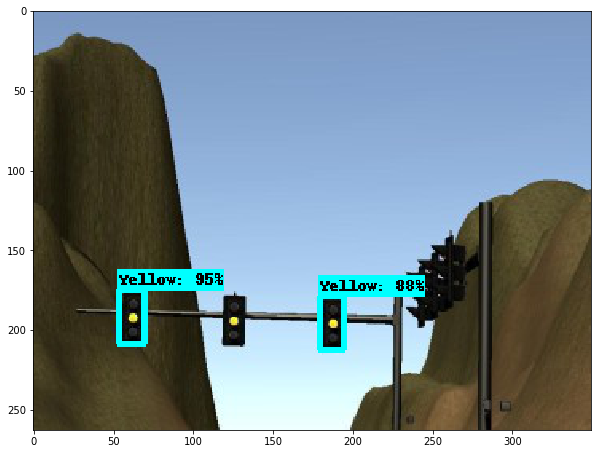

Yellow 0.95012593
Distance (metres) 0.0
Time in milliseconds 106.30083084106445 

Yellow 0.8846628
Distance (metres) 0.0
Time in milliseconds 106.30083084106445 



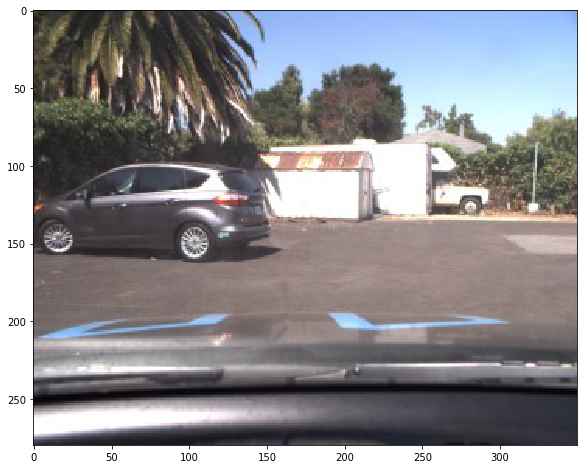

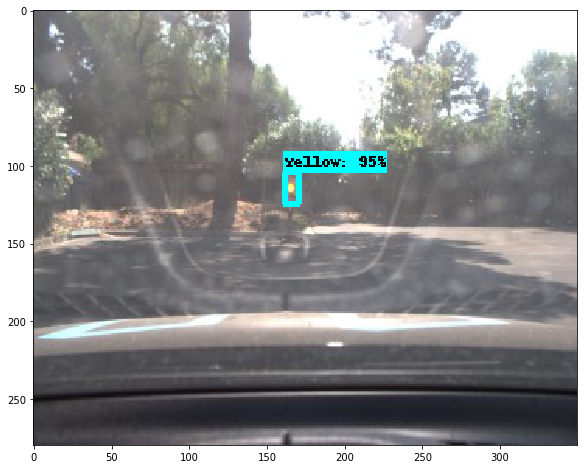

Yellow 0.9549977
Distance (metres) 0.0
Time in milliseconds 185.90712547302246 



In [51]:
with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
        # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        for image_path in DATA_PATHS:
            image = Image.open(image_path)
            # the array based representation of the image will be used later in order to prepare the
            # result image with boxes and labels on it.
            image_np = load_image_into_numpy_array(image)
            # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
            image_np_expanded = np.expand_dims(image_np, axis=0)

            time0 = time.time()

            # Actual detection.
            (boxes, scores, classes, num) = sess.run(
              [detection_boxes, detection_scores, detection_classes, num_detections],
              feed_dict={image_tensor: image_np_expanded})

            time1 = time.time()

            boxes = np.squeeze(boxes)
            scores = np.squeeze(scores)
            classes = np.squeeze(classes).astype(np.int32)
            
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np, boxes, classes, scores,
                category_index,
                use_normalized_coordinates=True,
                line_thickness=4)
            
            plt.figure(figsize=IMAGE_SIZE)
            plt.imshow(image_np)
            plt.show()

            min_score_thresh = .50
            for i in range(boxes.shape[0]):
                if scores is None or scores[i] > min_score_thresh:

                    class_name = category_index[classes[i]]['name']
                    print('{}'.format(class_name), scores[i])
                    
                    fx =  0.97428  #1345.200806
                    fy =  1.73205  #1353.838257
                    perceived_width_x = (boxes[i][3] - boxes[i][1]) * 800
                    perceived_width_y = (boxes[i][2] - boxes[i][0]) * 600

                    # ymin, xmin, ymax, xmax = box
                    # depth_prime = (width_real * focal) / perceived_width
                    perceived_depth_x = ((.1 * fx) / perceived_width_x)
                    perceived_depth_y = ((.3 * fy) / perceived_width_y )

                    estimated_distance = round((perceived_depth_x + perceived_depth_y) / 2)
                    print("Distance (metres)", estimated_distance)
                    print("Time in milliseconds", (time1 - time0) * 1000, "\n")